In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from math import sqrt

%matplotlib inline

pd.set_option("display.max_rows", 50)
pd.set_option("display.max_columns", 100)

import seaborn as sns

import geopandas as gpd
from shapely.geometry import Point, Polygon
from functools import partial
import pyproj
import shapely.geometry as sg

In [2]:
test_file = './datasets/test.csv'
train_file = './datasets/train.csv'
spray_file = './datasets/spray.csv'
weather_file = './datasets/weather.csv'
cleantest_file = './datasets/cleaned_test.csv'
trained_preds_file = './datasets/trained_preds.csv'

train_df = pd.read_csv(train_file)
cleantest_df = pd.read_csv(cleantest_file)
test_df = pd.read_csv(test_file)
spray_df = pd.read_csv(spray_file)
weather_df = pd.read_csv(weather_file)
trained_preds_df = pd.read_csv(trained_preds_file)

In [3]:
spray_df.head(20)

,Date,Time,Latitude,Longitude
0,2011-08-29,6:56:58 PM,42.391623,-88.089163
1,2011-08-29,6:57:08 PM,42.391348,-88.089163
2,2011-08-29,6:57:18 PM,42.391022,-88.089157
3,2011-08-29,6:57:28 PM,42.390637,-88.089158
4,2011-08-29,6:57:38 PM,42.390410,-88.088858
5,2011-08-29,6:57:48 PM,42.390395,-88.088315
6,2011-08-29,6:57:58 PM,42.390673,-88.088002
7,2011-08-29,6:58:08 PM,42.391027,-88.088002
8,2011-08-29,6:58:18 PM,42.391403,-88.088003
9,2011-08-29,6:58:28 PM,42.391718,-88.087995


In [4]:
spray_df['Date'] = pd.to_datetime(spray_df['Date'])
spray_df.set_index('Date', inplace=True)


train_df['Date'] = pd.to_datetime(train_df['Date'])
train_df.set_index('Date', inplace=True)

In [5]:
# Remove Longitude outliers
spray_df = spray_df.drop(spray_df[spray_df['Longitude']<-87.9].index)

# Remove Latitude outliers
spray_df = spray_df.drop(spray_df[spray_df['Latitude']>42.0].index)

In [6]:
# Dict of all 151 Traps coordinates

traps_coordinates = {
'T001': {'Latitude': 41.953705, 'Longitude': -87.733974},
 'T002': {'Latitude': 41.95469, 'Longitude': -87.800991},
 'T003': {'Latitude': 41.964242, 'Longitude': -87.757639},
 'T004': {'Latitude': 41.962728, 'Longitude': -87.748367},
 'T005': {'Latitude': 41.942114, 'Longitude': -87.776385},
 'T006': {'Latitude': 41.990284, 'Longitude': -87.797127},
 'T007': {'Latitude': 41.994991, 'Longitude': -87.769279},
 'T008': {'Latitude': 42.008314, 'Longitude': -87.777921},
 'T009': {'Latitude': 41.981964, 'Longitude': -87.812827},
 'T009__2': {'Latitude': 41.992478, 'Longitude': -87.862995},
 'T011': {'Latitude': 41.944869, 'Longitude': -87.832763},
 'T012': {'Latitude': 41.991429, 'Longitude': -87.747113},
 'T013': {'Latitude': 41.923738, 'Longitude': -87.785288},
 'T014': {'Latitude': 41.970248, 'Longitude': -87.787992},
 'T015': {'Latitude': 41.974089, 'Longitude': -87.824812},
 'T016': {'Latitude': 42.011601, 'Longitude': -87.811506},
 'T017': {'Latitude': 41.960616, 'Longitude': -87.777189},
 'T018': {'Latitude': 42.010412, 'Longitude': -87.66214},
 'T019': {'Latitude': 41.94983, 'Longitude': -87.698457},
 'T025': {'Latitude': 41.979243, 'Longitude': -87.750938},
 'T027': {'Latitude': 41.984809, 'Longitude': -87.728492},
 'T028': {'Latitude': 41.986921, 'Longitude': -87.689778},
 'T030': {'Latitude': 41.89923, 'Longitude': -87.716788},
 'T031': {'Latitude': 41.801498, 'Longitude': -87.763416},
 'T033': {'Latitude': 41.906638, 'Longitude': -87.701431},
 'T034': {'Latitude': 41.843811, 'Longitude': -87.686763},
 'T035': {'Latitude': 41.836644, 'Longitude': -87.677737},
 'T035__2': {'Latitude': 41.763733, 'Longitude': -87.742302},
 'T036': {'Latitude': 41.837085, 'Longitude': -87.729384},
 'T037': {'Latitude': 41.921177, 'Longitude': -87.79518},
 'T039': {'Latitude': 41.911824, 'Longitude': -87.726737},
 'T040': {'Latitude': 41.852652, 'Longitude': -87.719887},
 'T043': {'Latitude': 41.857402, 'Longitude': -87.694991},
 'T044': {'Latitude': 41.883284, 'Longitude': -87.705085},
 'T045': {'Latitude': 41.9216, 'Longitude': -87.666455},
 'T046': {'Latitude': 41.891118, 'Longitude': -87.654491},
 'T047': {'Latitude': 41.868142, 'Longitude': -87.696269},
 'T048': {'Latitude': 41.867108, 'Longitude': -87.654224},
 'T049': {'Latitude': 41.896282, 'Longitude': -87.655232},
 'T050': {'Latitude': 41.919343, 'Longitude': -87.694259},
 'T051': {'Latitude': 41.846283, 'Longitude': -87.656913},
 'T054': {'Latitude': 41.921965, 'Longitude': -87.632085},
 'T054C': {'Latitude': 41.925652, 'Longitude': -87.63359},
 'T060': {'Latitude': 41.823065, 'Longitude': -87.678378},
 'T061': {'Latitude': 41.801179, 'Longitude': -87.679447},
 'T062': {'Latitude': 41.800737, 'Longitude': -87.71188},
 'T063': {'Latitude': 41.82561, 'Longitude': -87.726549},
 'T065': {'Latitude': 41.778297, 'Longitude': -87.752411},
 'T066': {'Latitude': 41.77166, 'Longitude': -87.703047},
 'T067': {'Latitude': 41.759346, 'Longitude': -87.745602},
 'T069': {'Latitude': 41.768388, 'Longitude': -87.678649},
 'T070': {'Latitude': 41.797616, 'Longitude': -87.797894},
 'T071': {'Latitude': 41.781416, 'Longitude': -87.776532},
 'T072': {'Latitude': 41.74785, 'Longitude': -87.702716},
 'T073': {'Latitude': 41.773215, 'Longitude': -87.60088},
 'T074': {'Latitude': 41.822536, 'Longitude': -87.666343},
 'T075': {'Latitude': 41.799282, 'Longitude': -87.585487},
 'T076': {'Latitude': 41.794781, 'Longitude': -87.615989},
 'T077': {'Latitude': 41.778748, 'Longitude': -87.586427},
 'T078': {'Latitude': 41.775051, 'Longitude': -87.655356},
 'T079': {'Latitude': 41.766202, 'Longitude': -87.562889},
 'T080': {'Latitude': 41.754676, 'Longitude': -87.612922},
 'T081': {'Latitude': 41.821582, 'Longitude': -87.627796},
 'T082': {'Latitude': 41.803423, 'Longitude': -87.642984},
 'T083': {'Latitude': 41.754292, 'Longitude': -87.590773},
 'T084': {'Latitude': 41.692555, 'Longitude': -87.598865},
 'T085': {'Latitude': 41.721474, 'Longitude': -87.648064},
 'T086': {'Latitude': 41.688324, 'Longitude': -87.676709},
 'T088': {'Latitude': 41.869107, 'Longitude': -87.696293},
 'T089': {'Latitude': 41.723195, 'Longitude': -87.64997},
 'T090': {'Latitude': 41.868077, 'Longitude': -87.666901},
 'T091': {'Latitude': 41.862292, 'Longitude': -87.64886},
 'T092': {'Latitude': 41.869216, 'Longitude': -87.627561},
 'T094': {'Latitude': 41.720848, 'Longitude': -87.666014},
 'T094B': {'Latitude': 41.71914, 'Longitude': -87.669539},
 'T095': {'Latitude': 41.704336, 'Longitude': -87.703736},
 'T096': {'Latitude': 41.731922, 'Longitude': -87.677512},
 'T097': {'Latitude': 41.644612, 'Longitude': -87.604498},
 'T099': {'Latitude': 41.733643, 'Longitude': -87.55551},
 'T100': {'Latitude': 41.717753, 'Longitude': -87.531657},
 'T102': {'Latitude': 41.750498, 'Longitude': -87.605294},
 'T103': {'Latitude': 41.702724, 'Longitude': -87.536497},
 'T107': {'Latitude': 41.729669, 'Longitude': -87.582699},
 'T114': {'Latitude': 41.798697, 'Longitude': -87.736812},
 'T115': {'Latitude': 41.673408, 'Longitude': -87.599862},
 'T128': {'Latitude': 41.704572, 'Longitude': -87.565666},
 'T129': {'Latitude': 41.891126, 'Longitude': -87.61156},
 'T135': {'Latitude': 41.662014, 'Longitude': -87.724608},
 'T138': {'Latitude': 41.726465, 'Longitude': -87.585413},
 'T141': {'Latitude': 41.961743, 'Longitude': -87.76007},
 'T142': {'Latitude': 41.953067, 'Longitude': -87.776792},
 'T143': {'Latitude': 41.999129, 'Longitude': -87.795585},
 'T144': {'Latitude': 41.94016, 'Longitude': -87.794896},
 'T145': {'Latitude': 41.878114, 'Longitude': -87.629798},
 'T146': {'Latitude': 41.958271, 'Longitude': -87.702575},
 'T147': {'Latitude': 41.932094, 'Longitude': -87.700117},
 'T148': {'Latitude': 42.01743, 'Longitude': -87.687769},
 'T149': {'Latitude': 41.994469, 'Longitude': -87.667736},
 'T150': {'Latitude': 42.006858, 'Longitude': -87.675919},
 'T151': {'Latitude': 41.916265, 'Longitude': -87.800515},
 'T152': {'Latitude': 41.846075, 'Longitude': -87.716277},
 'T153': {'Latitude': 41.907645, 'Longitude': -87.760886},
 'T154': {'Latitude': 41.918705, 'Longitude': -87.752329},
 'T155': {'Latitude': 41.776156, 'Longitude': -87.778927},
 'T156': {'Latitude': 41.772846, 'Longitude': -87.740029},
 'T157': {'Latitude': 41.825902, 'Longitude': -87.667827},
 'T158': {'Latitude': 41.682587, 'Longitude': -87.707973},
 'T159': {'Latitude': 41.732984, 'Longitude': -87.649642},
 'T160': {'Latitude': 41.903002, 'Longitude': -87.688267},
 'T161': {'Latitude': 41.719059, 'Longitude': -87.675088},
 'T162': {'Latitude': 41.725517, 'Longitude': -87.614258},
 'T200': {'Latitude': 41.678618, 'Longitude': -87.559308},
 'T206': {'Latitude': 41.737052, 'Longitude': -87.543067},
 'T209': {'Latitude': 41.740641, 'Longitude': -87.546587},
 'T212': {'Latitude': 41.680946, 'Longitude': -87.535198},
 'T215': {'Latitude': 41.686398, 'Longitude': -87.531635},
 'T218': {'Latitude': 41.948167, 'Longitude': -87.730698},
 'T219': {'Latitude': 41.966987, 'Longitude': -87.674677},
 'T220': {'Latitude': 41.963976, 'Longitude': -87.69181},
 'T221': {'Latitude': 41.659112, 'Longitude': -87.538693},
 'T222': {'Latitude': 41.925198, 'Longitude': -87.746381},
 'T223': {'Latitude': 41.973845, 'Longitude': -87.805059},
 'T224': {'Latitude': 41.947227, 'Longitude': -87.671457},
 'T225': {'Latitude': 41.743402, 'Longitude': -87.731435},
 'T226': {'Latitude': 41.793818, 'Longitude': -87.654234},
 'T227': {'Latitude': 41.728495, 'Longitude': -87.600963},
 'T228': {'Latitude': 41.951866, 'Longitude': -87.725057},
 'T229': {'Latitude': 41.753411, 'Longitude': -87.639817},
 'T230': {'Latitude': 41.904194, 'Longitude': -87.756155},
 'T231': {'Latitude': 41.98728, 'Longitude': -87.666066},
 'T232': {'Latitude': 41.912563, 'Longitude': -87.668055},
 'T233': {'Latitude': 42.009876, 'Longitude': -87.807277},
 'T235': {'Latitude': 41.776428, 'Longitude': -87.627096},
 'T236': {'Latitude': 41.994679, 'Longitude': -87.770899},
 'T237': {'Latitude': 41.738903, 'Longitude': -87.695443},
 'T238': {'Latitude': 41.753391, 'Longitude': -87.707394},
 'T900': {'Latitude': 41.974689, 'Longitude': -87.890615},
 'T903': {'Latitude': 41.957799, 'Longitude': -87.930995},
 'T090A': {'Latitude': 41.690423, 'Longitude': -87.656929},
 'T090C': {'Latitude': 41.675876, 'Longitude': -87.651515},
 'T128A': {'Latitude': 41.738583, 'Longitude': -87.567726},
 'T234': {'Latitude': 41.942285, 'Longitude': -87.761726},
 'T218B': {'Latitude': 41.94828, 'Longitude': -87.74134},
 'T065A': {'Latitude': 41.777689, 'Longitude': -87.749149},
 'T002A': {'Latitude': 41.965571, 'Longitude': -87.781978},
 'T090B': {'Latitude': 41.868533, 'Longitude': -87.661638},
 'T200A': {'Latitude': 41.731929, 'Longitude': -87.54854},
 'T218C': {'Latitude': 41.933652, 'Longitude': -87.738416},
 'T002B': {'Latitude': 41.951878, 'Longitude': -87.789234},
 'T218A': {'Latitude': 41.95477, 'Longitude': -87.73089},
 'T200B': {'Latitude': 41.646541, 'Longitude': -87.543762}
}

In [7]:
# Create a Traps df with all the coords
traps_df = pd.DataFrame([(traps_coordinates[trap]['Longitude'], traps_coordinates[trap]['Latitude']) for trap in traps_coordinates.keys()], 
                    columns=['Longitude','Latitude'])

traps_df['trap'] = [trap for trap in traps_coordinates.keys()]

traps_df

,Longitude,Latitude,trap
0,-87.733974,41.953705,T001
1,-87.800991,41.954690,T002
2,-87.757639,41.964242,T003
3,-87.748367,41.962728,T004
4,-87.776385,41.942114,T005
...,...,...,...
146,-87.548540,41.731929,T200A
147,-87.738416,41.933652,T218C
148,-87.789234,41.951878,T002B
149,-87.730890,41.954770,T218A


In [8]:
# Define a function to create a col for YearWeek

def year_week(row):
    week = row['week']
    year = row['year']
    row['YearWeek'] = f'{year}{week}'
    row['YearWeek'] = int(row['YearWeek'])
    return row


def year_month(row):
    month = row['month']
    year = row['year']
    row['YearMonth'] = f'{year}{month}'
    row['YearMonth'] = int(row['YearMonth'])
    return row

In [9]:
train_df['day'] = train_df.index.day
train_df['week'] = train_df.index.week
train_df['month'] = train_df.index.month
train_df['year'] = train_df.index.year
train_df['dayofweek'] = train_df.index.dayofweek

spray_df['day'] = spray_df.index.day
spray_df['week'] = spray_df.index.week
spray_df['month'] = spray_df.index.month
spray_df['year'] = spray_df.index.year
spray_df['dayofweek'] = spray_df.index.dayofweek

# Create new col for YearWeek and YearMonth
train_df = train_df.apply(year_week, axis=1)
train_df = train_df.apply(year_month, axis=1)

spray_df = spray_df.apply(year_week, axis=1)
spray_df = spray_df.apply(year_month, axis=1)

C:\Users\leagu\AppData\Local\Temp\ipykernel_6584\60067942.py:2: FutureWarning: weekofyear and week have been deprecated, please use DatetimeIndex.isocalendar().week instead, which returns a Series. To exactly reproduce the behavior of week and weekofyear and return an Index, you may call pd.Int64Index(idx.isocalendar().week)
  train_df['week'] = train_df.index.week
C:\Users\leagu\AppData\Local\Temp\ipykernel_6584\60067942.py:8: FutureWarning: weekofyear and week have been deprecated, please use DatetimeIndex.isocalendar().week instead, which returns a Series. To exactly reproduce the behavior of week and weekofyear and return an Index, you may call pd.Int64Index(idx.isocalendar().week)
  spray_df['week'] = spray_df.index.week


In [10]:
# Read shapefile of Chicago city map
street_map = gpd.read_file('./datasets/chicago_boundaries')

In [11]:
street_map.crs

<Geographic 2D CRS: GEOGCS["WGS84(DD)",DATUM["WGS84",SPHEROID["WGS84", ...>
Name: WGS84(DD)
Axis Info [ellipsoidal]:
- lon[east]: Longitude (degree)
- lat[north]: Latitude (degree)
Area of Use:
- undefined
Datum: WGS84
- Ellipsoid: WGS84
- Prime Meridian: Greenwich

In [12]:
# Create geopandas DataFrame for both spray and traps data

crs = {'init':'epsg:4326'}
spray_geometry = [Point(xy) for xy in zip(spray_df['Longitude'], spray_df['Latitude'])]
trap_geometry = [Point(xy) for xy in [(traps_coordinates[trap]['Longitude'], traps_coordinates[trap]['Latitude']) for trap in traps_coordinates.keys()]]
train_geometry =  [Point(xy) for xy in zip(train_df['Longitude'], train_df['Latitude'])]


geo_spray_df = gpd.GeoDataFrame(spray_df, crs=crs, geometry=spray_geometry)

geo_traps_df = gpd.GeoDataFrame(traps_df, crs=crs, geometry=trap_geometry)

geo_train_df = gpd.GeoDataFrame(train_df, crs=crs, geometry=train_geometry)

C:\Users\leagu\anaconda3\envs\datascience\lib\site-packages\pyproj\crs\crs.py:141: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method. When making the change, be mindful of axis order changes: https://pyproj4.github.io/pyproj/stable/gotchas.html#axis-order-changes-in-proj-6
  in_crs_string = _prepare_from_proj_string(in_crs_string)
C:\Users\leagu\anaconda3\envs\datascience\lib\site-packages\pyproj\crs\crs.py:141: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method. When making the change, be mindful of axis order changes: https://pyproj4.github.io/pyproj/stable/gotchas.html#axis-order-changes-in-proj-6
  in_crs_string = _prepare_from_proj_string(in_crs_string)
C:\Users\leagu\anaconda3\envs\datascience\lib\site-packages\pyproj\crs\crs.py:141: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred i

In [13]:
geo_spray_df['2013-07']

C:\Users\leagu\anaconda3\envs\datascience\lib\site-packages\geopandas\geodataframe.py:1415: FutureWarning: Indexing a DataFrame with a datetimelike index using a single string to slice the rows, like `frame[string]`, is deprecated and will be removed in a future version. Use `frame.loc[string]` instead.
  result = super().__getitem__(key)


,Time,Latitude,Longitude,day,week,month,year,dayofweek,YearWeek,YearMonth,geometry
Date,,,,,,,,,,,
2013-07-25,8:51:16 PM,41.960520,-87.739783,25,30,7,2013,3,201330,20137,POINT (-87.73978 41.96052)
2013-07-25,8:51:26 PM,41.960515,-87.739787,25,30,7,2013,3,201330,20137,POINT (-87.73979 41.96052)
2013-07-25,8:51:36 PM,41.960508,-87.739787,25,30,7,2013,3,201330,20137,POINT (-87.73979 41.96051)
2013-07-25,8:51:46 PM,41.960498,-87.739792,25,30,7,2013,3,201330,20137,POINT (-87.73979 41.96050)
2013-07-25,8:51:56 PM,41.960527,-87.739800,25,30,7,2013,3,201330,20137,POINT (-87.73980 41.96053)
...,...,...,...,...,...,...,...,...,...,...,...
2013-07-25,10:28:37 PM,41.952447,-87.715325,25,30,7,2013,3,201330,20137,POINT (-87.71533 41.95245)
2013-07-25,10:28:57 PM,41.952045,-87.714633,25,30,7,2013,3,201330,20137,POINT (-87.71463 41.95204)
2013-07-25,10:29:07 PM,41.952062,-87.713948,25,30,7,2013,3,201330,20137,POINT (-87.71395 41.95206)


C:\Users\leagu\anaconda3\envs\datascience\lib\site-packages\geopandas\geodataframe.py:1415: FutureWarning: Indexing a DataFrame with a datetimelike index using a single string to slice the rows, like `frame[string]`, is deprecated and will be removed in a future version. Use `frame.loc[string]` instead.
  result = super().__getitem__(key)
C:\Users\leagu\anaconda3\envs\datascience\lib\site-packages\geopandas\geodataframe.py:1415: FutureWarning: Indexing a DataFrame with a datetimelike index using a single string to slice the rows, like `frame[string]`, is deprecated and will be removed in a future version. Use `frame.loc[string]` instead.
  result = super().__getitem__(key)


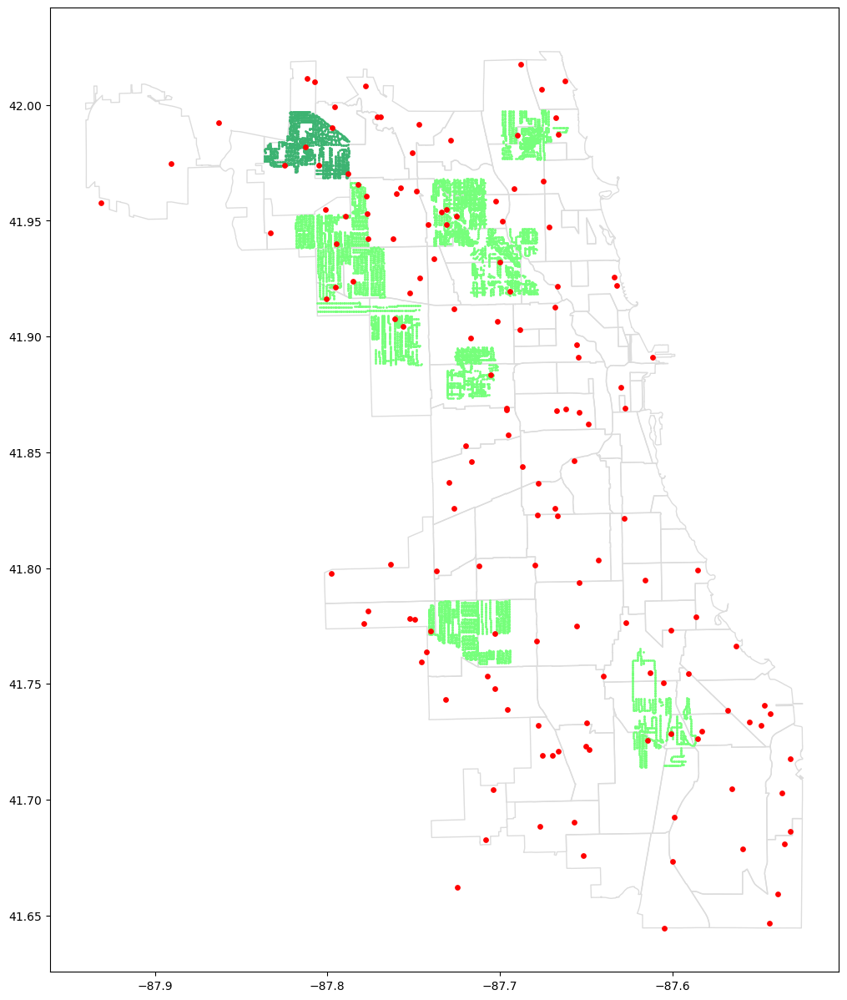

In [14]:
# Plot map of sprays done and traps' locations (geometry in degrees)
fig, ax = plt.subplots(figsize=(15,15))
street_map.plot(ax=ax, color='none', edgecolor='gainsboro')
geo_spray_df['2011'].plot(ax=ax, markersize=1, color='mediumseagreen', marker='o')
geo_spray_df['2013'].plot(ax=ax, markersize=1, color='#76FF7B', marker='o')
geo_traps_df.plot(ax=ax, markersize=15, color='red', marker='o');

# Most sprays done in the north as expected where there are higher concentrations of WnvPresent and NumMosquitos
# Sprays done in the south also corresponds to areas where there have been a sharp increase in NumMosquitos clusters

In [15]:
# Convert geo_spray and geo_traps POINT geometry to metres instead of degrees
geo_spray_meters = geo_spray_df.to_crs('EPSG:2263')
geo_traps_meters = geo_traps_df.to_crs('EPSG:2263')

In [16]:
geo_traps_meters

,Longitude,Latitude,trap,geometry
0,-87.733974,41.953705,T001,POINT (-2737002.928 943458.872)
1,-87.800991,41.954690,T002,POINT (-2754954.891 946667.299)
2,-87.757639,41.964242,T003,POINT (-2742761.559 948258.278)
3,-87.748367,41.962728,T004,POINT (-2740356.648 947318.876)
4,-87.776385,41.942114,T005,POINT (-2749061.209 941090.820)
...,...,...,...,...
146,-87.548540,41.731929,T200A,POINT (-2699614.920 855771.386)
147,-87.738416,41.933652,T218C,POINT (-2739338.206 936428.513)
148,-87.789234,41.951878,T002B,POINT (-2751956.518 945153.414)
149,-87.730890,41.954770,T218A,POINT (-2736113.570 943711.282)


<AxesSubplot: >

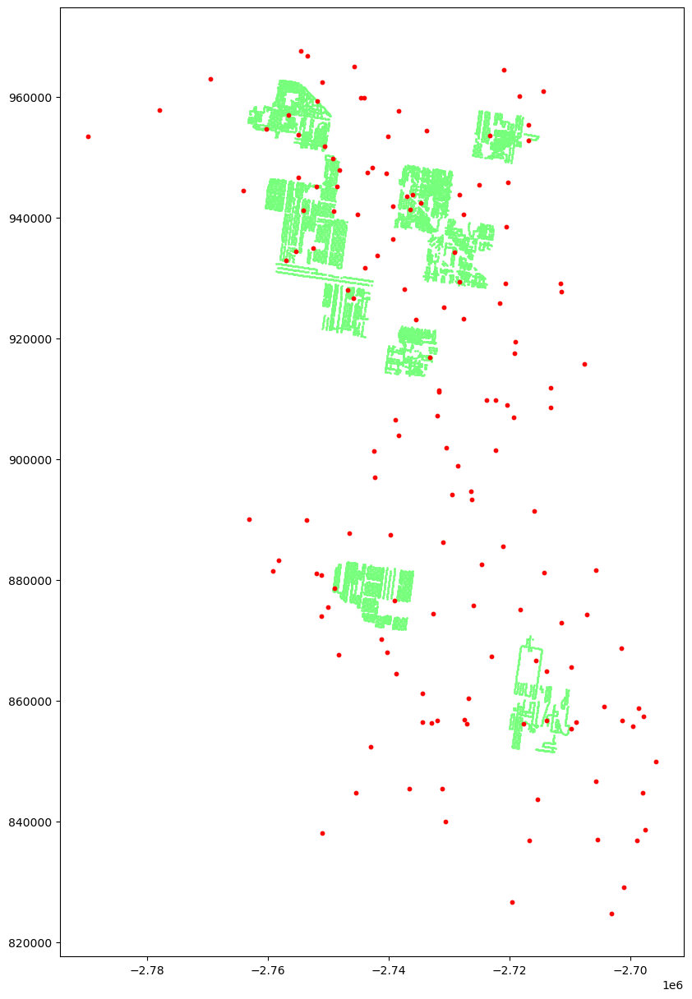

In [17]:
# Plot map of sprays done and traps' locations using coords in metres

fig, ax1 = plt.subplots(figsize=(15,15))
geo_spray_meters.plot(ax=ax1, markersize=1, color='#76FF7B', marker='o')
geo_traps_meters.plot(ax=ax1, markersize=10, color='red', marker='o')

In [18]:
# Testing calcs to compute distance in meters between spray points and trap
distances = geo_spray_meters.geometry.distance(geo_traps_meters.iloc[0].geometry)
distances

Date
2011-09-07    17785.244546
2011-09-07    17696.045838
2011-09-07    17603.002814
2011-09-07    17529.324033
2011-09-07    17441.735297
                  ...     
2013-08-29    16706.377293
2013-08-29    16555.220968
2013-08-29    16390.913335
2013-08-29    16261.114380
2013-08-29    16100.872422
Length: 11614, dtype: float64

<AxesSubplot: >

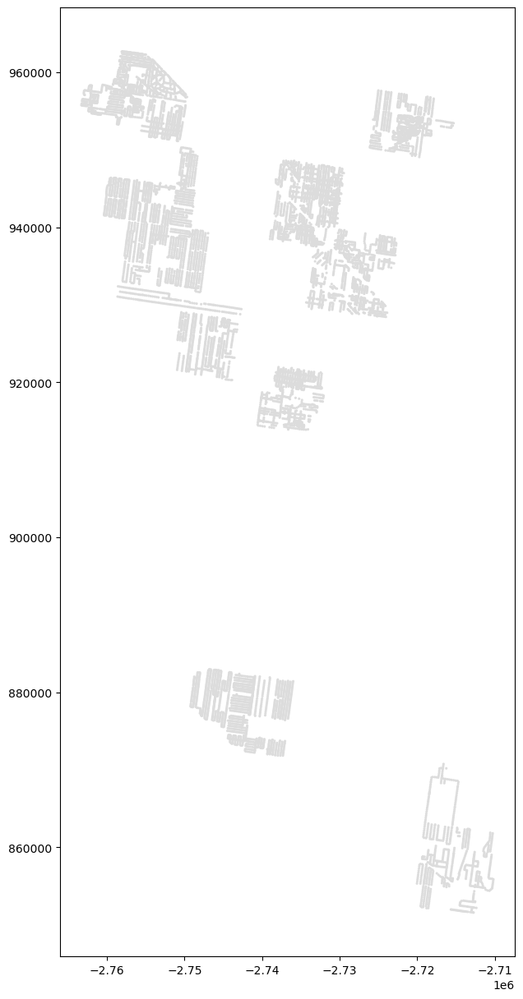

In [19]:
# Visualizing the sprays' effective zones

buffer_zone = geo_spray_meters.geometry.buffer(90)   # input buffer zone in metres

fig, ax2 = plt.subplots(figsize=(15,15))
buffer_zone.plot(ax=ax2, color='none', edgecolor='gainsboro')

In [20]:
# Lumping all the sprays' buffer zones together as one multipolygon geometry object
my_union = buffer_zone.geometry.unary_union
my_union

In [21]:
# Iterating through the 151 traps to see if any falls within 90m radius of each spray point

count=0
for i in range(len(geo_traps_meters)):
    if my_union.contains(geo_traps_meters.iloc[i].geometry):
        count+=1
        
print(count)

# Within 50m: only 8 traps in zone
# Within 90m: only 14 traps in zone
# Within 100m: only 14 traps in zone (which are these 14 traps?)
# Within 400m: only 30 traps in zone
# Within 1km: only 33 traps in zone (rest are not within the spray buffer zone anymore)

# So next question is: how far a zone is each spray effective for?
# With only 14 traps within zone, it seems deliberate that sprays are done while avoiding the Traps to produce accurate sampling results

14


The effective range of West Nile virus (WNV) sprays can vary depending on several factors, including the type of pesticide used, the spray method, and environmental conditions. However, in general, the effective range of WNV sprays is typically between 100-300 feet (30-90 meters) from the point of application.

Most WNV sprays use an ultra-low volume (ULV) spray method, which creates small droplets that can be carried by the wind. The droplets can drift and disperse, potentially reaching areas beyond the immediate vicinity of the application. However, the effectiveness of the spray decreases as the distance from the point of application increases.

In [22]:
# Identify the 14 Traps which fall within the buffer zone of any of the sprays
traps_in_zone = []

for i in range(len(geo_traps_meters)):
    if my_union.contains(geo_traps_meters.iloc[i].geometry):
        traps_in_zone.append(list(traps_coordinates.items())[i][0])   # create list to get dict keys by index pos
        

In [23]:
buffer_zone

Date
2011-09-07    POLYGON ((-2749786.358 955730.372, -2749786.79...
2011-09-07    POLYGON ((-2749811.658 955573.854, -2749812.09...
2011-09-07    POLYGON ((-2749832.225 955415.354, -2749832.65...
2011-09-07    POLYGON ((-2749851.992 955285.021, -2749852.42...
2011-09-07    POLYGON ((-2749879.302 955124.516, -2749879.73...
                                    ...                        
2013-08-29    POLYGON ((-2722000.544 950990.397, -2722000.97...
2013-08-29    POLYGON ((-2722102.054 950855.721, -2722102.48...
2013-08-29    POLYGON ((-2722294.776 950873.162, -2722295.21...
2013-08-29    POLYGON ((-2722424.854 950842.609, -2722425.28...
2013-08-29    POLYGON ((-2722556.704 950748.381, -2722557.13...
Length: 11614, dtype: geometry

In [24]:
geo_traps_meters

,Longitude,Latitude,trap,geometry
0,-87.733974,41.953705,T001,POINT (-2737002.928 943458.872)
1,-87.800991,41.954690,T002,POINT (-2754954.891 946667.299)
2,-87.757639,41.964242,T003,POINT (-2742761.559 948258.278)
3,-87.748367,41.962728,T004,POINT (-2740356.648 947318.876)
4,-87.776385,41.942114,T005,POINT (-2749061.209 941090.820)
...,...,...,...,...
146,-87.548540,41.731929,T200A,POINT (-2699614.920 855771.386)
147,-87.738416,41.933652,T218C,POINT (-2739338.206 936428.513)
148,-87.789234,41.951878,T002B,POINT (-2751956.518 945153.414)
149,-87.730890,41.954770,T218A,POINT (-2736113.570 943711.282)


In [25]:
traps_in_zone

# What are the counts of WnvPresent in these 14 Traps? Must be zero?


# These are traps in test set but missing in train set
# ['T002B',
#  'T234',
#  'T128A',
#  'T218A',
#  'T090A',
#  'T218C',
#  'T002A',
#  'T200B',
#  'T065A',
#  'T218B',
#  'T200A',
#  'T090C',
#  'T090B']

['T006',
 'T014',
 'T015',
 'T037',
 'T044',
 'T050',
 'T153',
 'T218',
 'T223',
 'T228',
 'T230',
 'T002A',
 'T002B',
 'T218A']

In [26]:
# Find the total count of WnvPresent in each of the 14 traps-in-zone
train_df[train_df['Trap'].isin(traps_in_zone)].groupby('Trap')['WnvPresent'].sum()

# The other 3 traps are in the test_df
# The fact that even with sprays, Wnv was still present in these traps mean that likely it has been ensured
# that the testing of traps did not clash with the spraying while it was still effective?

Trap
T006    4
T014    4
T015    4
T037    1
T044    0
T050    0
T153    0
T218    2
T223    9
T228    6
T230    7
Name: WnvPresent, dtype: int64

In [27]:
spray_df['month'].value_counts()

# Sprayed the most in August

8    7893
9    2114
7    1607
Name: month, dtype: int64

In [28]:
spray_df['year'].value_counts()

# Sprayed the most in 2013

2013    9500
2011    2114
Name: year, dtype: int64

In [29]:
spray_df['day'].value_counts()

15    2668
29    2302
7     2114
25    1607
22    1587
8     1195
16     141
Name: day, dtype: int64

In [30]:
spray_df['dayofweek'].value_counts()

# They only sprayed on Tues, Wed, Thurs, most of it on Wed, probably after all traps' samples have been collected for testing.
# Most of the sprays are done in Aug, 2013, when it was found that there was a huge spike in WnvPresent (containing the fire)
# Infer: Very Reactive spray program

3    9359
2    2114
4     141
Name: dayofweek, dtype: int64

In [31]:
spray_df['YearMonth'].value_counts()

# Most sprayed in Aug, 2013
# Only sprayed in Jul-Aug, 2013 and Sep, 2011

20138    7893
20119    2114
20137    1607
Name: YearMonth, dtype: int64

In [32]:
spray_df['YearWeek'].value_counts()

# Most sprayed in Aug, 2013, intensively every single week of Aug 2013 (Wk 32,33,34,35), around 1-2 times a week
# They sprayed so intensively and extensively during Aug 2013 was because there was a huge spike in WnvPresent
# Infer: They sprayed reactively (i.e. spray only when there are WnvPresent in large numbers from Traps)

201333    2809
201335    2302
201136    2114
201330    1607
201334    1587
201332    1195
Name: YearWeek, dtype: int64

In [33]:
# Create a col that indicates whether the trap falls within 90m of the spray point
traps_df['trap_in_spray'] = np.where(traps_df['trap'].isin(traps_in_zone), 1, 0)

In [34]:
geo_train_df['WnvPresent']

Date
2007-05-29    0
2007-05-29    0
2007-05-29    0
2007-05-29    0
2007-05-29    0
             ..
2013-09-26    1
2013-09-26    0
2013-09-26    0
2013-09-26    0
2013-09-26    0
Name: WnvPresent, Length: 10506, dtype: int64

# Evaluating the Efficacy of Chicago's Spray Program in 2011 and 2013

In [35]:
# In 2013, traps were sampled for the months of Jun-Sep. However, only 1 Trap T094 tested positive for WnvPresent. 
# Our model does not recommend spraying at T094 so no need to visualize plot for Jun, 2013

# Total NumMosquitos for Jun, 2013
Wnv_NumMosquitos_201306 = geo_train_df.loc[(geo_train_df.index >= '2013-06-01')&(geo_train_df.index <= '2013-06-30')].groupby('Trap')[['WnvPresent','NumMosquitos']].sum().reset_index()
Wnv_NumMosquitos_201306 = pd.merge(Wnv_NumMosquitos_201306, geo_train_df[['Trap','geometry']].drop_duplicates(), on='Trap')
# convert to geopandasDataFrame for plotting
geo_Wnv_NumMosquitos_201306 = gpd.GeoDataFrame(Wnv_NumMosquitos_201306, crs=crs, geometry='geometry')

# Total NumMosquitos for Jul-Aug, 2013
Wnv_NumMosquitos_20130708 = geo_train_df.loc[(geo_train_df.index >= '2013-07-01')&(geo_train_df.index <= '2013-08-31')].groupby('Trap')[['WnvPresent','NumMosquitos']].sum().reset_index()
Wnv_NumMosquitos_20130708 = pd.merge(Wnv_NumMosquitos_20130708, geo_train_df[['Trap','geometry']].drop_duplicates(), on='Trap')
# convert to geopandasDataFrame for plotting
geo_Wnv_NumMosquitos_20130708 = gpd.GeoDataFrame(Wnv_NumMosquitos_20130708, crs=crs, geometry='geometry')

# Total NumMosquitos for Sep, 2013
Wnv_NumMosquitos_201309 = geo_train_df.loc[(geo_train_df.index >= '2013-09-01')&(geo_train_df.index <= '2013-09-30')].groupby('Trap')[['WnvPresent','NumMosquitos']].sum().reset_index()
Wnv_NumMosquitos_201309 = pd.merge(Wnv_NumMosquitos_201309, geo_train_df[['Trap','geometry']].drop_duplicates(), on='Trap')
# convert to geopandasDataFrame for plotting
geo_Wnv_NumMosquitos_201309 = gpd.GeoDataFrame(Wnv_NumMosquitos_201309, crs=crs, geometry='geometry')




# Total NumMosquitos for Jul-Aug, 2011
Wnv_NumMosquitos_20110708 = geo_train_df.loc[(geo_train_df.index >= '2011-07-01')&(geo_train_df.index <= '2011-08-30')].groupby('Trap')[['WnvPresent','NumMosquitos']].sum().reset_index()
Wnv_NumMosquitos_20110708 = pd.merge(Wnv_NumMosquitos_20110708, geo_train_df[['Trap','geometry']].drop_duplicates(), on='Trap')
# convert to geopandasDataFrame for plotting
geo_Wnv_NumMosquitos_20110708 = gpd.GeoDataFrame(Wnv_NumMosquitos_20110708, crs=crs, geometry='geometry')
geo_Wnv_NumMosquitos_20110708

# Total NumMosquitos for Sep, 2011
Wnv_NumMosquitos_201109 = geo_train_df.loc[(geo_train_df.index >= '2011-09-01')&(geo_train_df.index <= '2011-09-30')].groupby('Trap')[['WnvPresent','NumMosquitos']].sum().reset_index()
Wnv_NumMosquitos_201109 = pd.merge(Wnv_NumMosquitos_201109, geo_train_df[['Trap','geometry']].drop_duplicates(), on='Trap')
# convert to geopandasDataFrame for plotting
geo_Wnv_NumMosquitos_201109 = gpd.GeoDataFrame(Wnv_NumMosquitos_201109, crs=crs, geometry='geometry')
geo_Wnv_NumMosquitos_201109

# Total NumMosquitos for Oct, 2011 
Wnv_NumMosquitos_201110 = geo_train_df.loc[(geo_train_df.index >= '2011-10-01')&(geo_train_df.index <= '2011-10-31')].groupby('Trap')['NumMosquitos'].sum().to_frame().reset_index()
Wnv_NumMosquitos_201110 = pd.merge(Wnv_NumMosquitos_201110, geo_train_df[['Trap','geometry']].drop_duplicates(), on='Trap')
# convert to geopandasDataFrame for plotting
geo_Wnv_NumMosquitos_201110 = gpd.GeoDataFrame(Wnv_NumMosquitos_201110, crs=crs, geometry='geometry')


C:\Users\leagu\anaconda3\envs\datascience\lib\site-packages\pyproj\crs\crs.py:141: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method. When making the change, be mindful of axis order changes: https://pyproj4.github.io/pyproj/stable/gotchas.html#axis-order-changes-in-proj-6
  in_crs_string = _prepare_from_proj_string(in_crs_string)
C:\Users\leagu\anaconda3\envs\datascience\lib\site-packages\pyproj\crs\crs.py:141: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method. When making the change, be mindful of axis order changes: https://pyproj4.github.io/pyproj/stable/gotchas.html#axis-order-changes-in-proj-6
  in_crs_string = _prepare_from_proj_string(in_crs_string)
C:\Users\leagu\anaconda3\envs\datascience\lib\site-packages\pyproj\crs\crs.py:141: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred i

In [36]:
geo_Wnv_NumMosquitos_201306[geo_Wnv_NumMosquitos_201306['WnvPresent']==1]
# Only 1 Trap T094 tested positive for WnvPresent in Jun, 2013

,Trap,WnvPresent,NumMosquitos,geometry
39,T094,1,276,POINT (-87.66601 41.72085)


In [37]:
Wnv_NumMosquitos_201110['NumMosquitos'].values    # no data collected from Traps in Oct, 2011! 
# Cannot even evaluate effectiveness of their sprays done in Sep, 2011  (another sign of irregular and unjustifiable sampling)


array([], dtype=int64)

In [38]:
geo_spray_df['2011-09'].index.unique()
# They only sprayed on one day in Sep, 2011!! 7th Sep 2011 - WHY?

C:\Users\leagu\anaconda3\envs\datascience\lib\site-packages\geopandas\geodataframe.py:1415: FutureWarning: Indexing a DataFrame with a datetimelike index using a single string to slice the rows, like `frame[string]`, is deprecated and will be removed in a future version. Use `frame.loc[string]` instead.
  result = super().__getitem__(key)


DatetimeIndex(['2011-09-07'], dtype='datetime64[ns]', name='Date', freq=None)

In [39]:
# geo_spray_df['2011-07']
# geo_spray_df['2011-08']

# No spray data for Jul-Aug 2011 even though there a huge spike in WnvPresent in Aug - WHY? 

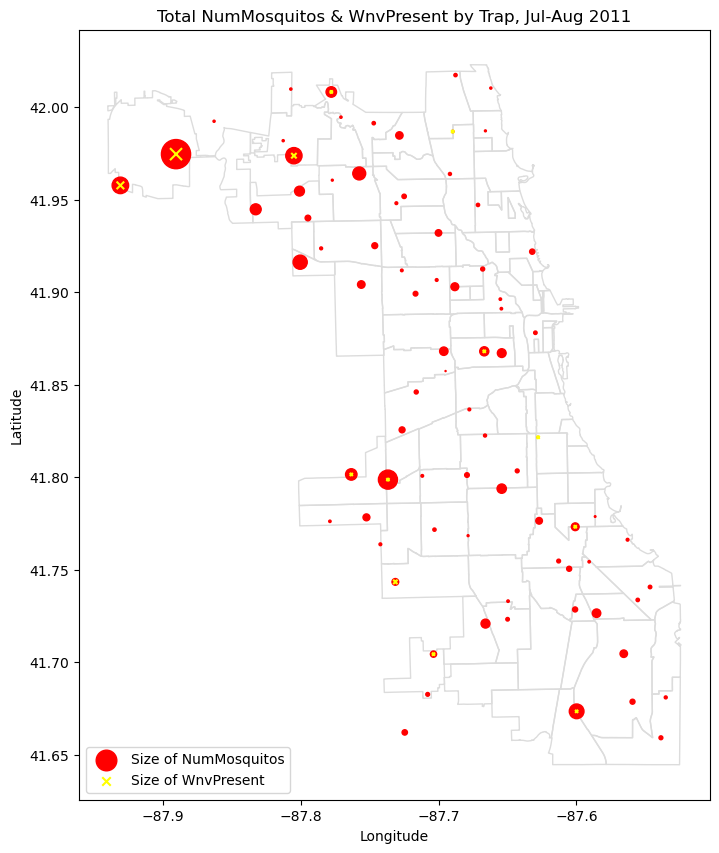

In [40]:
# Plot Sprays and NumMosquitos in Jul-Aug, 2011

fig, ax = plt.subplots(figsize=(10,10))
street_map.plot(ax=ax, color='none', edgecolor='gainsboro')

# geo_spray_df[('2011-07'].plot(ax=ax, markersize=1, color='#76FF7B', marker='o')   # no spray done in Jul 2011
# geo_spray_df['2011-08'].plot(ax=ax, markersize=1, color='#76FF7B', marker='o')    # no spray done in Aug 2011

geo_Wnv_NumMosquitos_20110708.plot(ax=ax, markersize=geo_Wnv_NumMosquitos_20110708['NumMosquitos'].values/5, color='red',  marker='o', label='Size of NumMosquitos')
geo_Wnv_NumMosquitos_20110708.plot(ax=ax, markersize=geo_Wnv_NumMosquitos_20110708['WnvPresent'].values*5, color='yellow',  marker='x', label='Size of WnvPresent')
plt.title('Total NumMosquitos & WnvPresent by Trap, Jul-Aug 2011')
plt.xlabel('Longitude')
plt.ylabel('Latitude')
plt.legend(loc='lower left');

C:\Users\leagu\anaconda3\envs\datascience\lib\site-packages\geopandas\geodataframe.py:1415: FutureWarning: Indexing a DataFrame with a datetimelike index using a single string to slice the rows, like `frame[string]`, is deprecated and will be removed in a future version. Use `frame.loc[string]` instead.
  result = super().__getitem__(key)


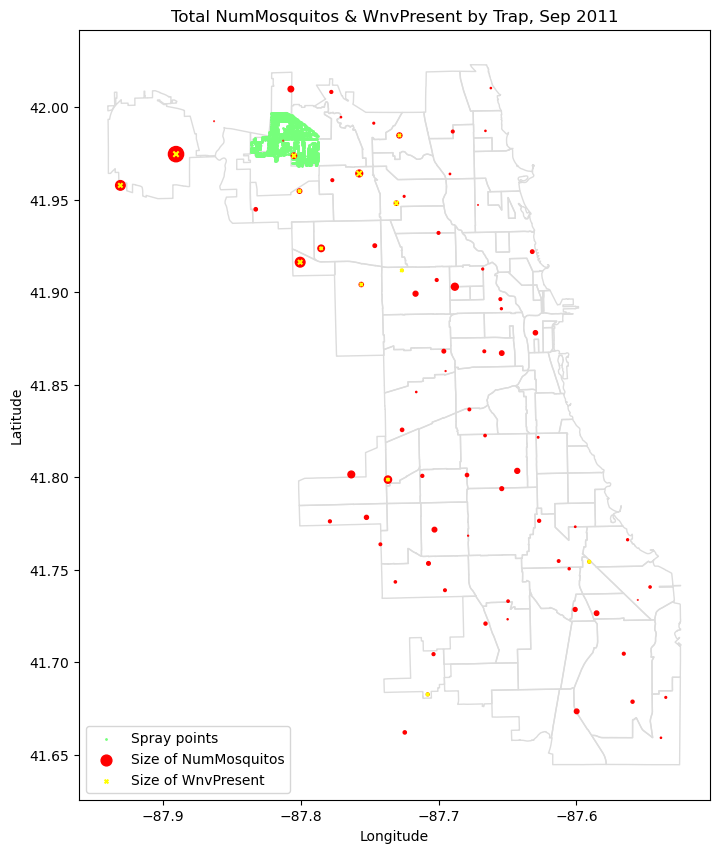

In [41]:
# Plot Sprays and NumMosquitos in Sep, 2011

fig, ax = plt.subplots(figsize=(10,10))
street_map.plot(ax=ax, color='none', edgecolor='gainsboro')
geo_spray_df['2011-09'].plot(ax=ax, markersize=1, color='#76FF7B', marker='o', label='Spray points')

geo_Wnv_NumMosquitos_201109.plot(ax=ax, markersize=geo_Wnv_NumMosquitos_201109['NumMosquitos'].values/5, color='red',  marker='o', label='Size of NumMosquitos')
geo_Wnv_NumMosquitos_201109.plot(ax=ax, markersize=geo_Wnv_NumMosquitos_201109['WnvPresent'].values*5, color='yellow',  marker='x', label='Size of WnvPresent')

plt.title('Total NumMosquitos & WnvPresent by Trap, Sep 2011')
plt.xlabel('Longitude')
plt.ylabel('Latitude')
plt.legend(loc='lower left');


# WnvPresent is mostly positively correlated to the NumMosquitos by Trap

C:\Users\leagu\anaconda3\envs\datascience\lib\site-packages\geopandas\geodataframe.py:1415: FutureWarning: Indexing a DataFrame with a datetimelike index using a single string to slice the rows, like `frame[string]`, is deprecated and will be removed in a future version. Use `frame.loc[string]` instead.
  result = super().__getitem__(key)
C:\Users\leagu\anaconda3\envs\datascience\lib\site-packages\geopandas\geodataframe.py:1415: FutureWarning: Indexing a DataFrame with a datetimelike index using a single string to slice the rows, like `frame[string]`, is deprecated and will be removed in a future version. Use `frame.loc[string]` instead.
  result = super().__getitem__(key)


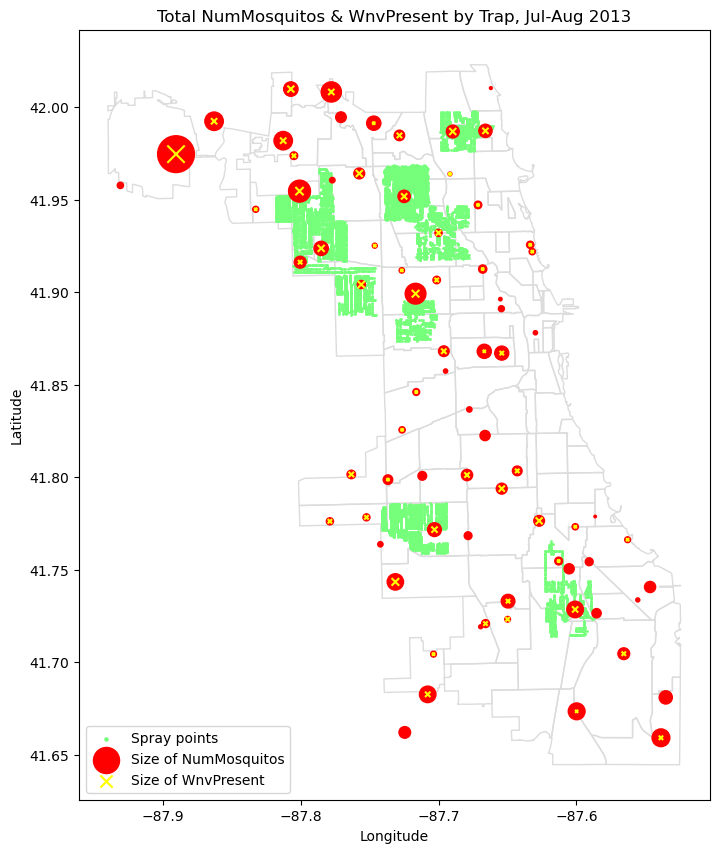

In [42]:
# Plot Sprays and NumMosquitos in Jul-Aug 2013

fig, ax = plt.subplots(figsize=(10,10))
street_map.plot(ax=ax, color='none', edgecolor='gainsboro')

geo_spray_df['2013-07'].plot(ax=ax, markersize=5, color='#76FF7B', marker='o', label='Spray points')
geo_spray_df['2013-08'].plot(ax=ax, markersize=1, color='#76FF7B', marker='o')
geo_Wnv_NumMosquitos_20130708.plot(ax=ax, markersize=geo_Wnv_NumMosquitos_20130708['NumMosquitos'].values/5, color='red',  marker='o', label='Size of NumMosquitos')
geo_Wnv_NumMosquitos_20130708.plot(ax=ax, markersize=geo_Wnv_NumMosquitos_20130708['WnvPresent'].values*5, color='yellow',  marker='x', label='Size of WnvPresent')

plt.title('Total NumMosquitos & WnvPresent by Trap, Jul-Aug 2013')
plt.xlabel('Longitude')
plt.ylabel('Latitude')
plt.legend(loc='lower left');


# A few observations we can make from this plot:
# WnvPresent is mostly positively correlated to the NumMosquitos by Trap
# Spray points mostly missed the most contagious hotspots

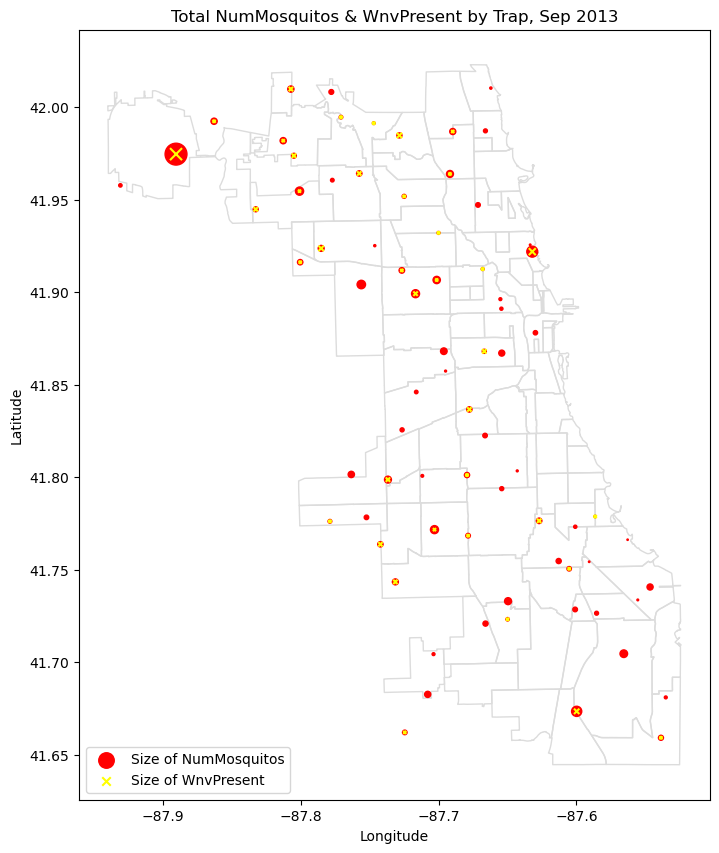

In [43]:
# Plot Sprays and NumMosquitos in Sep 2013

fig, ax = plt.subplots(figsize=(10,10))
street_map.plot(ax=ax, color='none', edgecolor='gainsboro')

# geo_spray_df['2013-09'].plot(ax=ax, markersize=1, color='#76FF7B', marker='o')    # no spray done in Sep 2013 

geo_Wnv_NumMosquitos_201309.plot(ax=ax, markersize=geo_Wnv_NumMosquitos_201309['NumMosquitos'].values/5, color='red',  marker='o', label='Size of NumMosquitos')
geo_Wnv_NumMosquitos_201309.plot(ax=ax, markersize=geo_Wnv_NumMosquitos_201309['WnvPresent'].values*5, color='yellow',  marker='x', label='Size of WnvPresent')

plt.title('Total NumMosquitos & WnvPresent by Trap, Sep 2013')
plt.xlabel('Longitude')
plt.ylabel('Latitude')
plt.legend(loc='lower left');

# WnvPresent is mostly positively correlated to the NumMosquitos by Trap

In [44]:
# SOME OBSERVATIONS:
# They only sprayed on Tues, Wed, Thurs, most of it on Wed, probably after all traps' samples have been collected for testing.
# Most of the sprays are done in Aug, 2013, when it was found that there was a huge spike in WnvPresent (containing the fire)
# Infer: Reactive spray program
# Why did they spray so much in Aug 2013? Did they learned their lesson from Aug 2007?

# Chicago spray efforts have been largely reactive it seems 
# But why did they not spray intensively back in Aug 2007 when there was an even bigger surge in WnvPresent? 
# They cannot have missed the huge number of WnvPresent during Aug 2007 since data has been collected from Traps for that month
# Was it because of the seemingly low NumMosquitos in Aug 2007? So they thought it might be self-contained pretty soon?
# And they only sprayed on one day in Sep, 2011!! 7th Sep 2011 - WHY?


# Similarly, in Sep 2013 when there was a continued outbreak in WnvPresent, why did the govt not continue their sprays? Why stop after Aug 2013?

# Have they been using a model that relies on current weather inputs and current Traps' samplings to decide when/where to spray?
# Very irregular and unjustifiable spray efforts of the Chicago govt!

# We do not have data on the type of sprays they are using but one thing for certain, the govt is not spraying correctly!




# Summary Inference: 
# The Chicago's spray program has been primarily Reactive, Irregular and spraying in the wrong places!
# Missing the Mark, Missing the Time, Reactive and not Preventive 

# Recommendation:
# Our model runs on leading indicators-only so it is actually very anticipatory. You have most of the weather inputs weeks beforehand and you can start planning ahead


# Let our model recommend When, Where and How Much to spray!

Besides pinpointing when and where to spray, our model also advises the size of spray coverage as bigger clusters of `NumMosquitos` or `WnvPresent` will necessarily warrant greater attention.  

To do that, we will have to create a new feature called `Wnv_NumMos_cluster` which is an interaction term between `NumMosquitos_cluster` and `trap_cluster` that we have created back in the `EDA_Train_Test_Sets`. By multiplying these two features together, we get a range of values from 1,2,3,4,6 where cluster 1 will be ignored for spraying and cluster 6 will require a wider area of sprays since both NumMosquito and WnvPresent are present in big clusters.  

|Wnv_NumMos_cluster|Spray radius in meters|
|---|---|
|1|No spraying needed|
|2|500|
|3|1000|
|4|2500|
|6|4000|

In [46]:
# Create a new costbenfit geopandas df for visualization

costbenefit = cleantest_df[['Date', 'Trap', 'NumMosquitos_cluster', 'trap_cluster']].copy()
costbenefit['Date'] = pd.to_datetime(costbenefit['Date'])
costbenefit.set_index('Date', inplace=True)
costbenefit['Wnv_NumMos_cluster'] = costbenefit['NumMosquitos_cluster'] * costbenefit['trap_cluster']

In [47]:
# Create new col for Wnv_NumMos_cluster(=NumMosquitos_cluster x trap_cluster)
geo_traps_meters['Wnv_NumMos_cluster'] = geo_traps_meters['trap'].apply(lambda x: costbenefit.loc[costbenefit['Trap']==x, 'Wnv_NumMos_cluster'][0])

geo_traps_meters

,Longitude,Latitude,trap,geometry,Wnv_NumMos_cluster
0,-87.733974,41.953705,T001,POINT (-2737002.928 943458.872),2
1,-87.800991,41.954690,T002,POINT (-2754954.891 946667.299),4
2,-87.757639,41.964242,T003,POINT (-2742761.559 948258.278),4
3,-87.748367,41.962728,T004,POINT (-2740356.648 947318.876),2
4,-87.776385,41.942114,T005,POINT (-2749061.209 941090.820),2
...,...,...,...,...,...
146,-87.548540,41.731929,T200A,POINT (-2699614.920 855771.386),3
147,-87.738416,41.933652,T218C,POINT (-2739338.206 936428.513),2
148,-87.789234,41.951878,T002B,POINT (-2751956.518 945153.414),4
149,-87.730890,41.954770,T218A,POINT (-2736113.570 943711.282),2


In [48]:
geo_traps_meters['Wnv_NumMos_cluster'].value_counts()

2    59
1    59
4    18
3     9
6     6
Name: Wnv_NumMos_cluster, dtype: int64

In [49]:
def make_buffer(geodf, zone):
    buffer_zone = geodf.geometry.buffer(zone)
    geometry = gpd.GeoSeries(buffer_zone)
    geometry.crs = 'EPSG:2263'   # need to set crs to meters first to convert to degrees later
    gdf = gpd.GeoDataFrame(geometry, columns=['geometry'])
    gdf = gdf.to_crs('EPSG:4326')   # in degrees unit for better visualization
    return gdf

In [50]:
def make_sprayzone(geodf):
    '''
    You can adjust the spray zone radius in meters in the param below
    e.g. cluster_2 has a spray radius of 1,500m from Trap centrepoint
    
    Note: Model does not recommend to spray at Cluster 1 as the NumMosquitos and total WnvPresent is too small to justify spraying
    '''
    cluster_2 = make_buffer(geodf[geodf['Wnv_NumMos_cluster']==2], 500)
    cluster_3 = make_buffer(geodf[geodf['Wnv_NumMos_cluster']==3], 1000)
    cluster_4 = make_buffer(geodf[geodf['Wnv_NumMos_cluster']==4], 2500)   # Increase spray radius as risk of contagion increases
    cluster_6 = make_buffer(geodf[geodf['Wnv_NumMos_cluster']==6], 4000)   # Highest risk of contagion
    return [cluster_2, cluster_3, cluster_4, cluster_6]

In [51]:
geo_Wnv_NumMosquitos_20110708

,Trap,WnvPresent,NumMosquitos,geometry
0,T002,0,251,POINT (-87.80099 41.95469)
1,T003,0,433,POINT (-87.75764 41.96424)
2,T008,1,286,POINT (-87.77792 42.00831)
3,T009,0,12,POINT (-87.81283 41.98196)
4,T009,0,12,POINT (-87.86299 41.99248)
...,...,...,...,...
75,T233,0,13,POINT (-87.80728 42.00988)
76,T235,0,114,POINT (-87.62710 41.77643)
77,T236,0,13,POINT (-87.77090 41.99468)
78,T900,15,2207,POINT (-87.89061 41.97469)


In [52]:
trained_preds_df['Date'] = pd.to_datetime(trained_preds_df['Date'])
trained_preds_df.set_index('Date', inplace=True)
trained_preds_df['Wnv_NumMos_cluster'] = trained_preds_df['NumMosquitos_cluster'] * trained_preds_df['trap_cluster']
trained_preds_df

,Latitude,Longitude,month_x,NumMosquitos_cluster,trap_cluster,daily_Tavg_lag_2,daily_rh_lag_2,daily_rh_lag_4,weekly_Tavg_lag_1,weekly_Tavg_lag_2,weekly_Tavg_lag_3,weekly_precip_lag_3,weekly_precip_lag_4,weekly_StnPressure_lag_2,weekly_StnPressure_lag_3,weekly_StnPressure_lag_4,superHot_Dry_lag_3,superHot_Wet_lag_3,Hot_Dry_lag_3,Hot_Wet_lag_3,Cool_Dry_lag_3,Cool_Wet_lag_3,superHot_Dry_lag_1,proba_0,proba_1,y_pred,WnvPresent,Wnv_NumMos_cluster
Date,,,,,,,,,,,,,,,,,,,,,,,,,,,,
2007-08-24,41.754292,-87.590773,8,1,1,79.5,75.304911,84.351626,70.285714,79.142857,77.928571,0.208571,0.065714,29.194286,29.272857,29.255714,1,0,0,0,0,0,0,0.495005,0.504995,1,0,1
2009-07-10,41.932094,-87.700117,7,2,1,63.0,77.906586,51.356790,66.214286,79.642857,71.214286,0.761429,0.142857,29.120601,29.120000,29.194286,0,1,0,0,0,0,0,0.603890,0.396110,0,0,2
2013-06-07,41.704336,-87.703736,6,1,2,63.5,59.181701,62.737691,66.285714,59.357143,66.142857,0.014286,0.078571,29.288571,29.180000,29.244286,0,0,1,0,0,0,0,0.776275,0.223725,0,0,2
2011-09-23,41.932094,-87.700117,9,2,1,63.5,59.181701,88.277015,59.071429,63.857143,74.857143,0.022857,0.092857,29.340000,29.235714,29.191429,0,1,0,0,0,0,0,0.554495,0.445505,0,0,2
2007-06-29,41.961743,-87.760070,6,2,1,81.0,69.303018,68.876268,70.857143,75.928571,65.857143,0.117143,0.050000,29.325714,29.101429,29.207143,0,0,0,1,0,0,0,0.553687,0.446313,0,0,2
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2007-09-24,41.725517,-87.614258,9,1,1,62.5,48.850513,70.477825,70.071429,58.285714,75.428571,0.067143,0.014286,29.358571,29.271429,29.402857,0,1,0,0,0,0,1,0.646229,0.353771,0,0,1
2007-08-15,41.896282,-87.655232,8,1,1,73.0,57.262967,64.360235,79.142857,77.928571,74.428571,0.065714,0.315714,29.272857,29.255714,29.312857,0,1,0,0,0,0,0,0.512493,0.487507,0,0,1
2007-08-15,41.963976,-87.691810,8,2,1,73.0,57.262967,64.360235,79.142857,77.928571,74.428571,0.065714,0.315714,29.272857,29.255714,29.312857,0,1,0,0,0,0,0,0.453556,0.546444,1,0,2


In [53]:
# Convert trained_preds_df to a geoDataFrame for plotting
trained_preds_geometry = [Point(xy) for xy in zip(trained_preds_df['Longitude'], trained_preds_df['Latitude'])]
geo_trained_preds = gpd.GeoDataFrame(trained_preds_df, crs=crs, geometry=trained_preds_geometry)
geo_trained_preds_meters = geo_trained_preds.to_crs('EPSG:2263')
geo_trained_preds_meters

C:\Users\leagu\anaconda3\envs\datascience\lib\site-packages\pyproj\crs\crs.py:141: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method. When making the change, be mindful of axis order changes: https://pyproj4.github.io/pyproj/stable/gotchas.html#axis-order-changes-in-proj-6
  in_crs_string = _prepare_from_proj_string(in_crs_string)


,Latitude,Longitude,month_x,NumMosquitos_cluster,trap_cluster,daily_Tavg_lag_2,daily_rh_lag_2,daily_rh_lag_4,weekly_Tavg_lag_1,weekly_Tavg_lag_2,weekly_Tavg_lag_3,weekly_precip_lag_3,weekly_precip_lag_4,weekly_StnPressure_lag_2,weekly_StnPressure_lag_3,weekly_StnPressure_lag_4,superHot_Dry_lag_3,superHot_Wet_lag_3,Hot_Dry_lag_3,Hot_Wet_lag_3,Cool_Dry_lag_3,Cool_Wet_lag_3,superHot_Dry_lag_1,proba_0,proba_1,y_pred,WnvPresent,Wnv_NumMos_cluster,geometry
Date,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
2007-08-24,41.754292,-87.590773,8,1,1,79.5,75.304911,84.351626,70.285714,79.142857,77.928571,0.208571,0.065714,29.194286,29.272857,29.255714,1,0,0,0,0,0,0,0.495005,0.504995,1,0,1,POINT (-2709746.578 865602.277)
2009-07-10,41.932094,-87.700117,7,2,1,63.0,77.906586,51.356790,66.214286,79.642857,71.214286,0.761429,0.142857,29.120601,29.120000,29.194286,0,1,0,0,0,0,0,0.603890,0.396110,0,0,2,POINT (-2729131.190 934241.831)
2013-06-07,41.704336,-87.703736,6,1,2,63.5,59.181701,62.737691,66.285714,59.357143,66.142857,0.014286,0.078571,29.288571,29.180000,29.244286,0,0,1,0,0,0,0,0.776275,0.223725,0,0,2,POINT (-2743036.804 852402.114)
2011-09-23,41.932094,-87.700117,9,2,1,63.5,59.181701,88.277015,59.071429,63.857143,74.857143,0.022857,0.092857,29.340000,29.235714,29.191429,0,1,0,0,0,0,0,0.554495,0.445505,0,0,2,POINT (-2729131.190 934241.831)
2007-06-29,41.961743,-87.760070,6,2,1,81.0,69.303018,68.876268,70.857143,75.928571,65.857143,0.117143,0.050000,29.325714,29.101429,29.207143,0,0,0,1,0,0,0,0.553687,0.446313,0,0,2,POINT (-2743557.192 947462.104)
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2007-09-24,41.725517,-87.614258,9,1,1,62.5,48.850513,70.477825,70.071429,58.285714,75.428571,0.067143,0.014286,29.358571,29.271429,29.402857,0,1,0,0,0,0,1,0.646229,0.353771,0,0,1,POINT (-2717701.689 856233.175)
2007-08-15,41.896282,-87.655232,8,1,1,73.0,57.262967,64.360235,79.142857,77.928571,74.428571,0.065714,0.315714,29.272857,29.255714,29.312857,0,1,0,0,0,0,0,0.512493,0.487507,0,0,1,POINT (-2719090.553 919448.099)
2007-08-15,41.963976,-87.691810,8,2,1,73.0,57.262967,64.360235,79.142857,77.928571,74.428571,0.065714,0.315714,29.272857,29.255714,29.312857,0,1,0,0,0,0,0,0.453556,0.546444,1,0,2,POINT (-2725089.074 945368.319)


In [54]:
# Let our model recommend the areas to spray and its coverage size

# Jul-Aug, 2011
traps_to_spray_20110708 = geo_trained_preds_meters.loc[(geo_trained_preds_meters.index >= '2011-07-01')&(geo_trained_preds_meters.index <= '2011-08-31')&(geo_trained_preds_meters['y_pred']==1)][['Wnv_NumMos_cluster','geometry']]
traps_to_spray_20110708 = traps_to_spray_20110708.reset_index().drop('Date', axis=1).drop_duplicates()

# Sep, 2011
traps_to_spray_201109 = geo_trained_preds_meters.loc[(geo_trained_preds_meters.index >= '2011-09-01')&(geo_trained_preds_meters.index <= '2011-09-30')&(geo_trained_preds_meters['y_pred']==1)][['Wnv_NumMos_cluster','geometry']]
traps_to_spray_201109 = traps_to_spray_201109.reset_index().drop('Date', axis=1).drop_duplicates()




# Jun, 2013 (no Traps to spray this month!)
traps_to_spray_201306 = geo_trained_preds_meters.loc[(geo_trained_preds_meters.index >= '2013-06-01')&(geo_trained_preds_meters.index <= '2013-06-30')&(geo_trained_preds_meters['y_pred']==1)][['Wnv_NumMos_cluster','geometry']]
traps_to_spray_201306 = traps_to_spray_201306.reset_index().drop('Date', axis=1).drop_duplicates()

# Jul-Aug, 2013
traps_to_spray_20130708 = geo_trained_preds_meters.loc[(geo_trained_preds_meters.index >= '2013-07-01')&(geo_trained_preds_meters.index <= '2013-08-31')&(geo_trained_preds_meters['y_pred']==1)][['Wnv_NumMos_cluster','geometry']]
traps_to_spray_20130708 = traps_to_spray_20130708.reset_index().drop('Date', axis=1).drop_duplicates()

# Sep, 2013
traps_to_spray_201309 = geo_trained_preds_meters.loc[(geo_trained_preds_meters.index >= '2013-09-01')&(geo_trained_preds_meters.index <= '2013-09-30')&(geo_trained_preds_meters['y_pred']==1)][['Wnv_NumMos_cluster','geometry']]
traps_to_spray_201309 = traps_to_spray_201309.reset_index().drop('Date', axis=1).drop_duplicates()



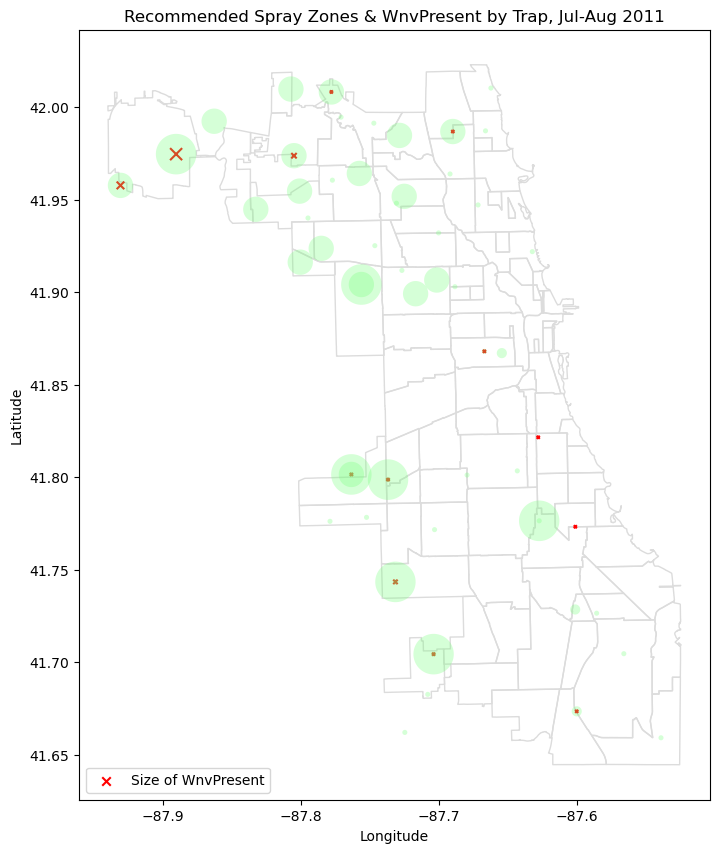

In [55]:
# Plot Recommended Sprays and actual WnvPresent in Jul-Aug, 2011

fig, ax = plt.subplots(figsize=(10,10))
street_map.plot(ax=ax, color='none', edgecolor='gainsboro')

# geo_Wnv_NumMosquitos_20110708.plot(ax=ax, markersize=geo_Wnv_NumMosquitos_20110708['NumMosquitos'].values/5, color='red',  marker='o', label='Size of NumMosquitos')
geo_Wnv_NumMosquitos_20110708.plot(ax=ax, markersize=geo_Wnv_NumMosquitos_20110708['WnvPresent'].values*5, color='red',  marker='x', label='Size of WnvPresent')

clusters = make_sprayzone(traps_to_spray_20110708)

for cluster in clusters:
    cluster.plot(ax=ax, markersize=10, color='#76FF7B', marker='o', alpha=0.30)


plt.title('Recommended Spray Zones & WnvPresent by Trap, Jul-Aug 2011')
plt.xlabel('Longitude')
plt.ylabel('Latitude')
plt.legend(loc='lower left');

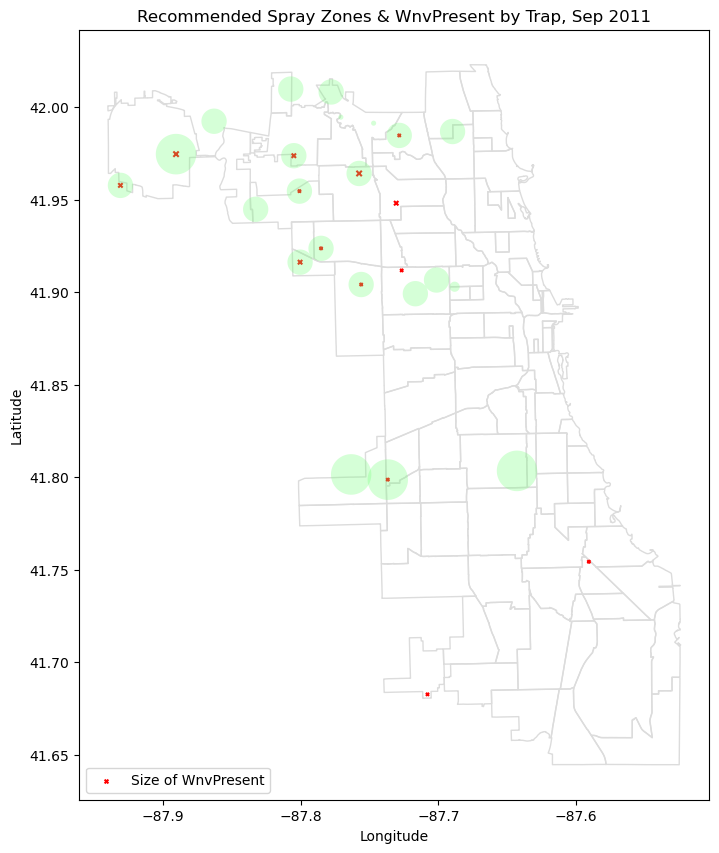

In [56]:
# Plot Recommended Sprays and actual WnvPresent in Sep, 2011

fig, ax = plt.subplots(figsize=(10,10))
street_map.plot(ax=ax, color='none', edgecolor='gainsboro')

# geo_Wnv_NumMosquitos_201109.plot(ax=ax, markersize=geo_Wnv_NumMosquitos_201109['NumMosquitos'].values/5, color='red',  marker='o', label='Size of NumMosquitos')
geo_Wnv_NumMosquitos_201109.plot(ax=ax, markersize=geo_Wnv_NumMosquitos_201109['WnvPresent'].values*5, color='red',  marker='x', label='Size of WnvPresent')

clusters = make_sprayzone(traps_to_spray_201109)

for cluster in clusters:
    cluster.plot(ax=ax, markersize=10, color='#76FF7B', marker='o', alpha=0.30);


plt.title('Recommended Spray Zones & WnvPresent by Trap, Sep 2011')
plt.xlabel('Longitude')
plt.ylabel('Latitude')
plt.legend(loc='lower left');

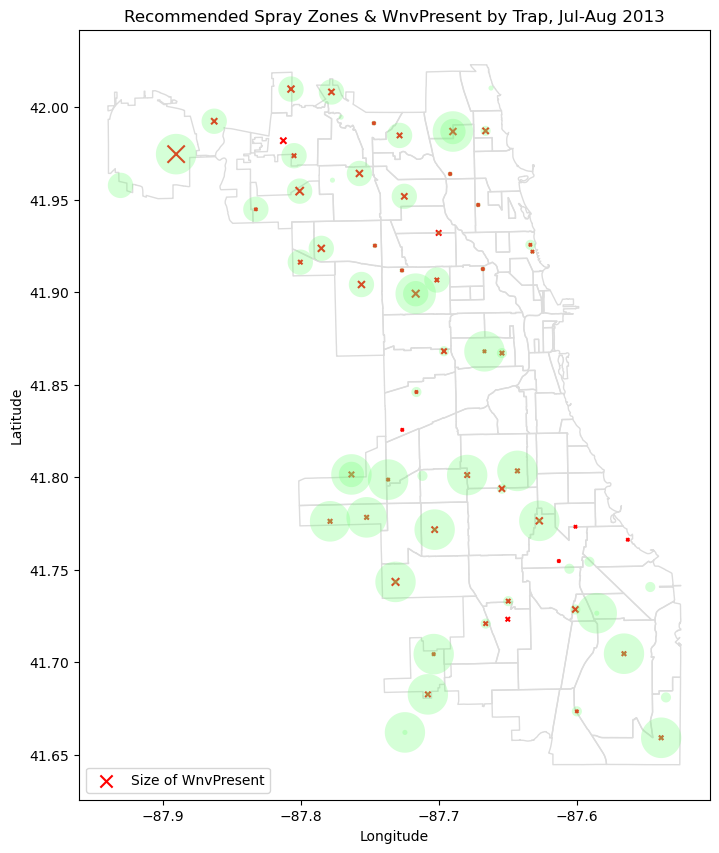

In [57]:
# Plot Recommended Sprays and actual WnvPresent in Jul-Aug, 2013

fig, ax = plt.subplots(figsize=(10,10))
street_map.plot(ax=ax, color='none', edgecolor='gainsboro')

# geo_Wnv_NumMosquitos_201109.plot(ax=ax, markersize=geo_Wnv_NumMosquitos_201109['NumMosquitos'].values/5, color='red',  marker='o', label='Size of NumMosquitos')
geo_Wnv_NumMosquitos_20130708.plot(ax=ax, markersize=geo_Wnv_NumMosquitos_20130708['WnvPresent'].values*5, color='red',  marker='x', label='Size of WnvPresent')

clusters = make_sprayzone(traps_to_spray_20130708)

for cluster in clusters:
    cluster.plot(ax=ax, markersize=10, color='#76FF7B', marker='o', alpha=0.30);


plt.title('Recommended Spray Zones & WnvPresent by Trap, Jul-Aug 2013')
plt.xlabel('Longitude')
plt.ylabel('Latitude')
plt.legend(loc='lower left');

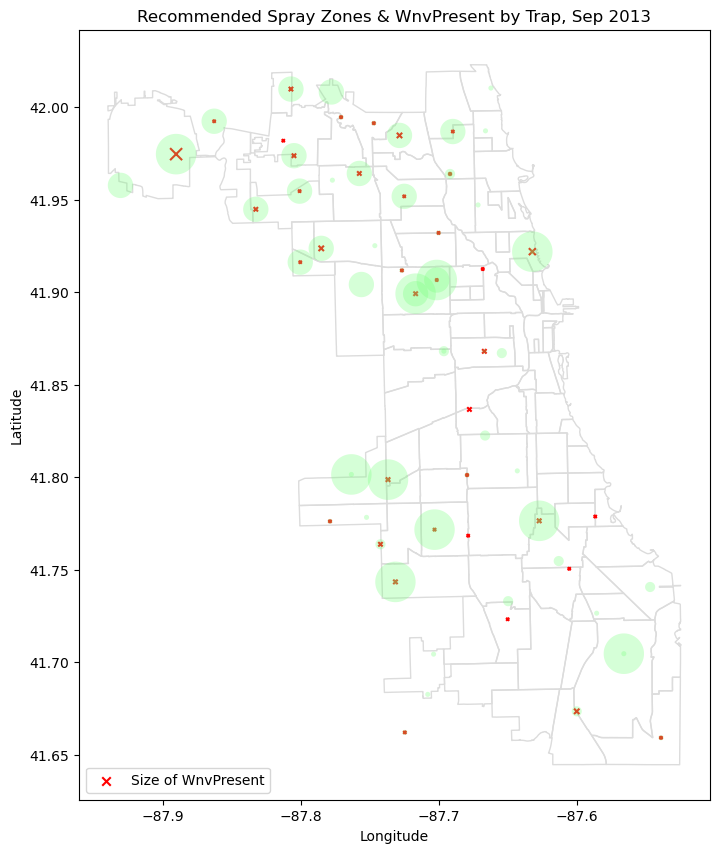

In [58]:
# Plot Recommended Sprays and actual WnvPresent in Sep, 2013

fig, ax = plt.subplots(figsize=(10,10))
street_map.plot(ax=ax, color='none', edgecolor='gainsboro')

# geo_Wnv_NumMosquitos_201109.plot(ax=ax, markersize=geo_Wnv_NumMosquitos_201109['NumMosquitos'].values/5, color='red',  marker='o', label='Size of NumMosquitos')
geo_Wnv_NumMosquitos_201309.plot(ax=ax, markersize=geo_Wnv_NumMosquitos_201309['WnvPresent'].values*5, color='red',  marker='x', label='Size of WnvPresent')

clusters = make_sprayzone(traps_to_spray_201309)

for cluster in clusters:
    cluster.plot(ax=ax, markersize=10, color='#76FF7B', marker='o', alpha=0.30);


plt.title('Recommended Spray Zones & WnvPresent by Trap, Sep 2013')
plt.xlabel('Longitude')
plt.ylabel('Latitude')
plt.legend(loc='lower left');

# Calculate Spray Area for Cost Analysis

In [59]:
# Get the total sprayed areas for 2013 only

sprayed_areas_2013 = geo_spray_meters.loc['2013'].geometry.buffer(100).unary_union     # assume Chicago sprayed an effective radius for 100m for each spray point
# sprayed_areas_2013.geom_type      # Easier to find total area from a MultiPolygon object (check using .geom_type)


areas_list = list(sprayed_areas_2013.geoms)
total_area = sum([poly.area for poly in areas_list])
print(f'Total Area Sprayed in 2013: {total_area} square meters // {total_area*0.00025} acres')

Total Area Sprayed in 2013: 240939840.82241055 square meters // 60234.96020560264 acres


In [60]:
# Visualization of Chicago sprayed areas in 2013
sprayed_areas_2013

In [61]:
# Calculate the total recommended areas to spray by our Model

all_traps_to_spray_2013 = pd.concat([traps_to_spray_20130708, traps_to_spray_201309])
sprayzones_2013 = make_sprayzone(all_traps_to_spray_2013)

# Use unary_union method so that there is no multiple-counting of overlapped regions 
geo_sprayzones_2013 = gpd.GeoDataFrame(sprayzones_2013[0])
geo_sprayzones_2013 = pd.concat([geo_sprayzones_2013, sprayzones_2013[1], sprayzones_2013[2], sprayzones_2013[3]])
geo_sprayzones_2013 = geo_sprayzones_2013.to_crs('EPSG:2263')   # convert degrees to meters units
to_spray_union = geo_sprayzones_2013.geometry.unary_union


to_spray_list = list(to_spray_union.geoms)
total_area_to_spray = sum([poly.area for poly in to_spray_list])
print(f'Total Spray Area Recommended in 2013: {total_area_to_spray} square meters // {total_area_to_spray*0.00025} acres')

Total Spray Area Recommended in 2013: 1352326209.958133 square meters // 338081.55248953326 acres


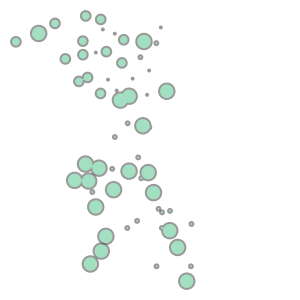

In [62]:
# Visualization of Recommended spray areas in 2013 by our model
to_spray_union